In [2]:
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from prepare import get_prepped

ERROR:fbprophet:Importing plotly failed. Interactive plots will not work.


In [3]:
df = get_prepped()

In [22]:
df.head()

,quantity,price,inflated,Caldas_mean_precip,Caldas_mean_temp,Caldas_min_temp,Cundinamarca_mean_precip,Cundinamarca_mean_temp,Cundinamarca_min_temp,Narino_mean_precip,...,Tolima_min_temp,Valle_mean_precip,Valle_mean_temp,Valle_min_temp,Cesar_mean_precip,Cesar_mean_temp,Cesar_min_temp,Santander_mean_precip,Santander_mean_temp,Santander_min_temp
date,,,,,,,,,,,,,,,,,,,,,
1960-01-01,782.0,45.68,387.519181,0.040000,72.500000,53.446162,0.280000,58.250000,30.875838,0.072655,...,62.826583,-0.054432,83.394728,72.399317,0.119673,85.574639,74.166190,0.111732,69.105673,59.956370
1960-02-01,449.0,45.95,389.809684,0.040000,72.210526,54.300065,0.082857,58.894737,31.438934,0.015172,...,64.635809,0.021487,83.592275,72.199709,-0.160911,86.849857,76.056101,0.167760,69.504415,60.659367
1960-03-01,266.0,45.10,382.598841,0.143158,71.875000,54.741925,0.124545,58.347826,34.199076,0.012903,...,66.368796,0.061226,83.154188,73.557848,-0.178350,87.567455,76.982745,0.154044,69.713106,61.178475
1960-04-01,264.0,45.20,383.447176,0.525000,72.687500,55.906027,0.113750,59.687500,38.081443,0.008000,...,67.912503,0.204186,82.330770,71.204803,-0.095321,87.131671,78.062566,0.203308,69.024617,61.300378
1960-05-01,602.0,44.73,379.460004,0.191000,72.181818,55.326548,0.276555,59.458333,38.367067,0.016774,...,67.875379,0.195359,81.782540,70.861052,0.042621,85.752403,78.742579,0.150532,69.160477,60.614402


In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 708 entries, 1960-01-01 to 2018-12-01
Data columns (total 42 columns):
quantity                    708 non-null float64
price                       708 non-null float64
inflated                    708 non-null float64
Caldas_mean_precip          708 non-null float64
Caldas_mean_temp            708 non-null float64
Caldas_min_temp             708 non-null float64
Cundinamarca_mean_precip    708 non-null float64
Cundinamarca_mean_temp      708 non-null float64
Cundinamarca_min_temp       708 non-null float64
Narino_mean_precip          708 non-null float64
Narino_mean_temp            708 non-null float64
Narino_min_temp             708 non-null float64
Cauca_mean_precip           708 non-null float64
Cauca_mean_temp             708 non-null float64
Cauca_min_temp              708 non-null float64
Risaralda_mean_precip       708 non-null float64
Risaralda_mean_temp         708 non-null float64
Risaralda_min_temp          708 non-null fl

In [24]:
df.describe()

,quantity,price,inflated,Caldas_mean_precip,Caldas_mean_temp,Caldas_min_temp,Cundinamarca_mean_precip,Cundinamarca_mean_temp,Cundinamarca_min_temp,Narino_mean_precip,...,Tolima_min_temp,Valle_mean_precip,Valle_mean_temp,Valle_min_temp,Cesar_mean_precip,Cesar_mean_temp,Cesar_min_temp,Santander_mean_precip,Santander_mean_temp,Santander_min_temp
count,708.000000,708.000000,708.000000,708.000000,708.000000,708.000000,708.000000,708.000000,708.000000,708.000000,...,708.000000,708.000000,708.000000,708.000000,708.000000,708.000000,708.000000,708.000000,708.000000,708.000000
mean,888.759887,117.042459,287.522823,0.205316,73.056972,59.601523,0.111022,55.799535,36.948408,0.168615,...,68.711412,0.303984,82.500963,70.799932,0.161536,85.741351,72.637999,0.143983,71.144774,62.385355
std,381.462823,60.337486,161.812973,0.194527,1.878465,3.126061,0.130392,1.238506,4.892166,0.208815,...,3.293696,0.226430,1.544705,3.481000,0.233844,1.780971,2.427677,0.198461,1.348889,2.002072
min,127.000000,37.270000,79.446600,0.000000,67.633333,41.000000,0.000000,52.096774,20.000000,0.000000,...,50.000000,-0.054432,76.500000,52.000000,-0.178350,80.000000,63.000000,0.000000,66.000000,50.000000
25%,620.750000,62.390000,165.116364,0.117473,71.734127,58.477283,0.052315,54.967742,34.000000,0.057231,...,67.010908,0.144649,81.571429,70.000000,0.018400,84.596552,71.400667,0.074420,70.168146,61.260518
50%,830.500000,122.592833,287.605531,0.189282,73.000000,60.171341,0.091488,55.741935,37.000000,0.136231,...,69.168936,0.276590,82.468180,71.550107,0.123731,85.835993,72.843232,0.126492,71.100750,63.000000
75%,1096.500000,150.430000,356.107896,0.248600,74.130108,61.733187,0.142182,56.612903,40.000000,0.216435,...,71.000000,0.413215,83.355415,72.000000,0.242173,86.963174,74.000000,0.167565,71.965150,63.813985
max,2755.000000,319.670000,1324.610143,2.550000,81.000000,69.000000,1.996667,59.935484,50.000000,2.775000,...,75.000000,1.711429,87.714286,77.000000,3.160000,91.000000,79.000000,4.620000,76.000000,68.000000


In [29]:
pd.plotting.register_matplotlib_converters()

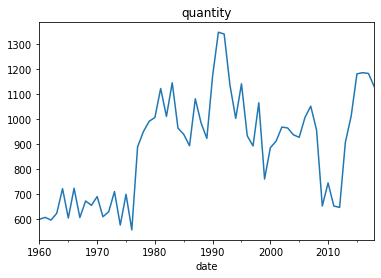

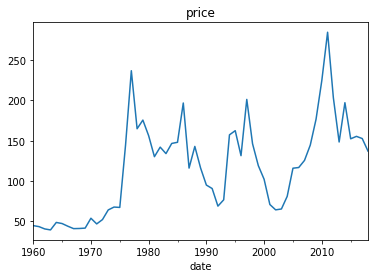

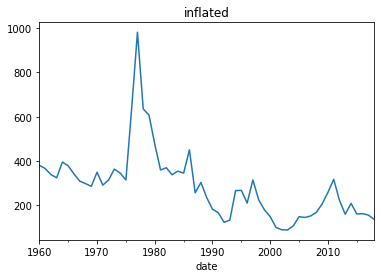

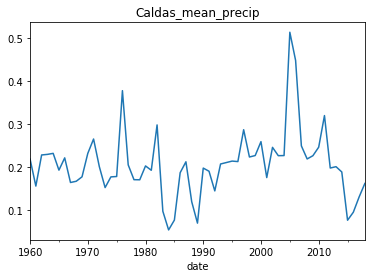

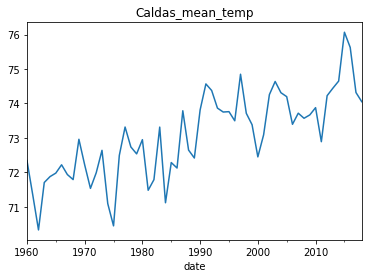

...

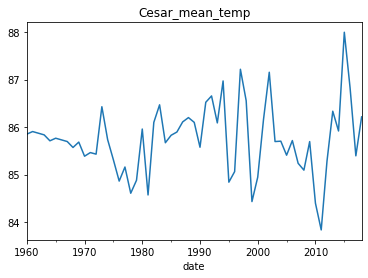

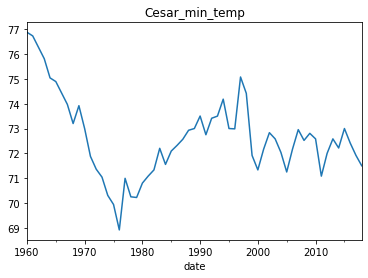

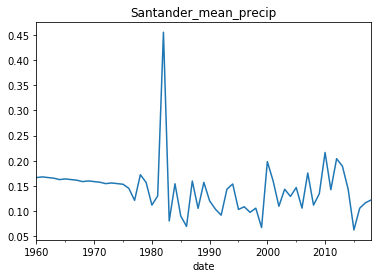

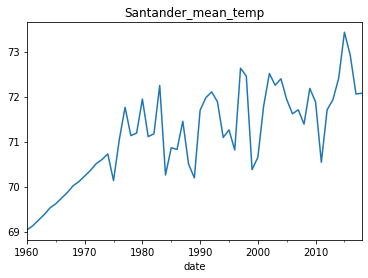

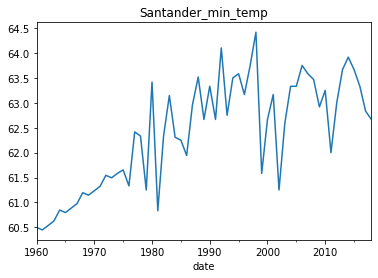

In [32]:
for col in df.columns:
    df[col].resample('Y').mean().plot(title=col)
    plt.show()

In [54]:
weights = pd.read_excel('coffee_data/colu_coffee_data.xlsx', sheet_name=7, index_col=1, header=5)
weights = weights.drop(columns='Unnamed: 0')
weights = weights.reset_index().rename(columns={'index': 'region'})

In [55]:
weights.head()

,region,2002,2003,2004,2005,2006,2007,2008,2009,2010*,2011*,2012*,2013*,2014*,2015*,2016*,2017*,2018*
0,Antioquia,127.992,128.051,129.296,129.816,126.3,126.9,129.1,130.574,131.123,131.167,133.613,137.12591,130.99440,128.62959,126.39590,123.25658,120.96247
1,Bolivar,n/d,n/d,n/d,n/d,n/d,n/d,n/d,n/d,n/d,n/d,n/d,0.99843,1.11661,1.15858,1.18293,1.23128,1.31422
2,Boyaca,11.3564,11.2253,11.0943,10.9632,10.8,11.1,10.7,10.9508,11.141,11.2725,10.3544,11.48672,11.40843,11.52441,11.44544,10.56771,10.41157
3,Caldas,88.8241,88.5069,90.8721,89.5204,89.1,87.7,85,83.8768,81.9181,80.5247,78.5766,77.55945,74.52824,72.36568,70.78863,68.96862,66.01964
4,Caquetá,n/d,n/d,n/d,n/d,n/d,2.8,2.8,2.77771,2.84768,3.43321,3.68109,4.08449,3.98915,4.09174,4.15590,4.05336,4.02463


In [56]:
weights = weights.iloc[:23]
weights

,region,2002,2003,2004,2005,2006,2007,2008,2009,2010*,2011*,2012*,2013*,2014*,2015*,2016*,2017*,2018*
0,Antioquia,127.992,128.051,129.296,129.816,126.3,126.9,129.1,130.574,131.123,131.167,133.613,137.12591,130.99440,128.62959,126.39590,123.25658,120.96247
1,Bolivar,n/d,n/d,n/d,n/d,n/d,n/d,n/d,n/d,n/d,n/d,n/d,0.99843,1.11661,1.15858,1.18293,1.23128,1.31422
2,Boyaca,11.3564,11.2253,11.0943,10.9632,10.8,11.1,10.7,10.9508,11.141,11.2725,10.3544,11.48672,11.40843,11.52441,11.44544,10.56771,10.41157
3,Caldas,88.8241,88.5069,90.8721,89.5204,89.1,87.7,85,83.8768,81.9181,80.5247,78.5766,77.55945,74.52824,72.36568,70.78863,68.96862,66.01964
4,Caquetá,n/d,n/d,n/d,n/d,n/d,2.8,2.8,2.77771,2.84768,3.43321,3.68109,4.08449,3.98915,4.09174,4.15590,4.05336,4.02463
5,Casanare,n/d,n/d,n/d,n/d,n/d,2.6,2.6,2.558,2.60526,2.73676,2.9194,3.19756,3.25252,3.20010,3.17087,2.91630,2.73515
6,Cauca,65.6812,68.4958,69.8519,68.9207,68,67.8,69.8,73.3378,76.1894,81.1701,84.0615,91.60854,88.82609,92.62337,95.75341,93.30242,92.56067
7,Cesar,22.4345,22.1868,21.8386,21.4905,21.1,21.5,21.9,22.4543,24.2262,26.1887,28.688,30.77295,30.28175,28.91111,29.01921,28.03272,25.95149
8,Chocó,n/d,n/d,n/d,n/d,n/d,0.18,0.189,0.20017,0.18983,0.20975,0.16745,0.16507,0.16060,0.16336,0.16359,0.17037,0.17086
9,Cundinamarca,55.445,54.3097,53.1744,52.0391,50.9,48.2,48.895,48.9189,49.3578,43.8546,40.7941,41.99428,37.99632,37.91638,37.67983,35.42518,32.32467


In [57]:
weights.iloc[:22].describe()

,2013*,2014*,2015*,2016*,2017*,2018*
count,22.000000,22.000000,22.000000,22.000000,22.000000,22.000000
mean,44.273242,43.115141,42.769068,42.352105,41.088702,39.870172
std,46.197037,45.345520,45.259735,44.831826,43.605317,43.123572
min,0.044790,0.128650,0.128650,0.000000,0.170370,0.170860
25%,4.756795,4.689325,4.599000,4.649598,4.505522,4.303592
50%,30.583565,28.977625,27.967350,27.352025,26.009110,24.753995
75%,64.363445,63.438205,61.078827,59.868680,58.374195,54.225368
max,154.492250,154.982930,154.087860,151.865610,147.804660,146.762700


In [58]:
weights = weights[weights['2018*'] > 60]

In [59]:
weights = weights.set_index('region')

In [71]:
for col in weights.columns:
    weights = weights.rename(columns={str(col): str(col)[0:4]})

In [72]:
weights

,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018
region,,,,,,,,,,,,,,,,,
Antioquia,127.992,128.051,129.296,129.816,126.3,126.9,129.1,130.574,131.123,131.167,133.613,137.12591,130.99440,128.62959,126.39590,123.25658,120.96247
Caldas,88.8241,88.5069,90.8721,89.5204,89.1,87.7,85,83.8768,81.9181,80.5247,78.5766,77.55945,74.52824,72.36568,70.78863,68.96862,66.01964
Cauca,65.6812,68.4958,69.8519,68.9207,68,67.8,69.8,73.3378,76.1894,81.1701,84.0615,91.60854,88.82609,92.62337,95.75341,93.30242,92.56067
Huila,78.2321,82.1984,93.9141,95.9206,95.1,98.1,102.5,104.987,117.842,129.153,139.139,154.49225,154.98293,154.08786,151.86561,147.80466,146.76270
Tolima,105.557,105.442,105.328,105.213,105.1,104.3,102.8,103.905,106.792,109.857,113.152,119.33305,117.17887,118.43105,117.27424,112.86673,111.71078
TOTAL,865.142,870.83,886.646,883.331,873.5,877.547,878.767,887.661,914.41,921.06,931.059,974.01132,948.53311,940.91950,931.74632,903.95144,877.14378


In [81]:
weights = weights.T

In [82]:
weights.columns

Index(['Antioquia', 'Caldas', 'Cauca', 'Huila', 'Tolima', 'TOTAL '], dtype='object', name='region')

In [83]:
weights

region,Antioquia,Caldas,Cauca,Huila,Tolima,TOTAL
2002,127.992,88.8241,65.6812,78.2321,105.557,865.142
2003,128.051,88.5069,68.4958,82.1984,105.442,870.83
2004,129.296,90.8721,69.8519,93.9141,105.328,886.646
2005,129.816,89.5204,68.9207,95.9206,105.213,883.331
2006,126.3,89.1,68,95.1,105.1,873.5
2007,126.9,87.7,67.8,98.1,104.3,877.547
2008,129.1,85,69.8,102.5,102.8,878.767
2009,130.574,83.8768,73.3378,104.987,103.905,887.661
2010,131.123,81.9181,76.1894,117.842,106.792,914.41
2011,131.167,80.5247,81.1701,129.153,109.857,921.06


In [84]:
weights.index

Index([  2002,   2003,   2004,   2005,   2006,   2007,   2008,   2009, '2010',
       '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018'],
      dtype='object')

In [85]:
weights.index = weights.index.astype(str)

In [86]:
weights.index

Index(['2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010',
       '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018'],
      dtype='object')

In [88]:
weights.index = pd.to_datetime(weights.index)

In [91]:
yearly = df.resample('YS').mean()
yearly = yearly[['quantity', 'inflated', 'Caldas_mean_precip', 'Caldas_mean_temp', 'Caldas_min_temp', 'Antioquia_mean_precip', 'Antioquia_mean_temp', 'Antioquia_min_temp', 'Cauca_mean_precip', 'Cauca_mean_temp', 'Cauca_min_temp', 'Huila_mean_precip', 'Huila_mean_temp', 'Huila_min_temp', 'Tolima_mean_precip', 'Tolima_mean_temp', 'Tolima_min_temp']]

In [93]:
yearly = yearly['2002':]

In [96]:
weights.columns

Index(['Antioquia', 'Caldas', 'Cauca', 'Huila', 'Tolima', 'TOTAL '], dtype='object', name='region')

In [98]:
for col in weights.drop(columns='TOTAL ').columns:
    yearly[col + '_weight'] = weights[col] / weights['TOTAL ']

INFO:numexpr.utils:NumExpr defaulting to 4 threads.


In [99]:
yearly

,quantity,inflated,Caldas_mean_precip,Caldas_mean_temp,Caldas_min_temp,Antioquia_mean_precip,Antioquia_mean_temp,Antioquia_min_temp,Cauca_mean_precip,Cauca_mean_temp,...,Huila_mean_temp,Huila_min_temp,Tolima_mean_precip,Tolima_mean_temp,Tolima_min_temp,Antioquia_weight,Caldas_weight,Cauca_weight,Huila_weight,Tolima_weight
date,,,,,,,,,,,,,,,,,,,,,
2002-01-01,967.833333,89.873723,0.245331,74.256338,62.000000,0.106754,53.748520,36.250000,0.945470,81.188029,...,83.770044,68.083333,0.373523,81.643859,71.176074,0.147944,0.10267,0.0759195,0.090427,0.122011
2003-01-01,964.000000,89.331588,0.225948,74.638190,59.750000,0.092036,53.786557,36.750000,1.047421,81.640741,...,83.945867,66.916667,0.331219,83.082810,71.092313,0.147045,0.101635,0.0786558,0.094391,0.121083
2004-01-01,936.666667,107.780178,0.226216,74.311556,62.026332,0.110992,54.430506,36.273748,0.660504,80.721361,...,83.821606,69.908265,0.305956,82.470046,71.164989,0.145826,0.10249,0.0787823,0.105921,0.118793
2005-01-01,926.583333,149.092435,0.513173,74.197391,60.500000,0.141754,54.257602,36.083333,0.592096,80.698729,...,83.150278,68.833333,0.257922,82.775160,71.623991,0.146962,0.101344,0.0780236,0.10859,0.119109
2006-01-01,1006.500000,145.493942,0.447565,73.394156,62.083333,0.108133,54.196090,36.750000,1.218850,81.488772,...,83.161122,70.250000,0.308490,82.665692,71.465626,0.144591,0.102003,0.0778477,0.108872,0.120321
2007-01-01,1051.500000,152.134211,0.248741,73.716927,62.342626,0.088157,53.401038,38.333333,0.807768,80.846910,...,83.110238,70.250000,0.521100,81.661299,70.622969,0.144608,0.0999377,0.0772608,0.111789,0.118854
2008-01-01,956.500000,168.613333,0.218338,73.569280,61.644965,0.109715,53.955267,37.707829,0.807796,80.579216,...,82.687163,69.958111,0.271277,81.211892,70.973099,0.14691,0.0967264,0.0794295,0.116641,0.116982
2009-01-01,651.000000,206.694848,0.225916,73.666861,61.426301,0.109344,54.175247,36.775242,0.756582,80.728981,...,82.633717,69.989939,0.306937,82.110135,70.555555,0.147098,0.0944919,0.0826191,0.118274,0.117055
2010-01-01,743.583333,258.634994,0.245731,73.877581,61.916667,0.120822,54.352209,36.916667,0.659430,80.716777,...,82.859702,69.416667,0.234890,82.165436,69.166667,0.143397,0.0895857,0.0833208,0.128872,0.116788


In [159]:
fields = ['_mean_precip', '_mean_temp', '_min_temp']
regions = weights.drop(columns='TOTAL ').columns
weighted = pd.DataFrame()

In [160]:
for field in fields:
    weighted['weighted' + field] = (yearly['Antioquia' + field] * yearly['Antioquia_weight']) \
+ (yearly['Caldas' + field] * yearly['Caldas_weight'])\
+ (yearly['Cauca' + field] * yearly['Cauca_weight'])\
+ (yearly['Huila'  + field] * yearly['Huila_weight'])\
+ (yearly['Tolima' + field] * yearly['Tolima_weight'])

In [161]:
weighted

,weighted_mean_precip,weighted_mean_temp,weighted_min_temp
date,,,
2002-01-01,0.174374,39.276,31.9723
2003-01-01,0.169703,39.9001,32.156
2004-01-01,0.143059,40.5883,33.254
2005-01-01,0.164443,40.6782,33.101
2006-01-01,0.211856,40.6668,33.5855
2007-01-01,0.184623,40.3322,33.6096
2008-01-01,0.178591,40.5881,33.6922
2009-01-01,0.15627,40.9846,33.7394
2010-01-01,0.154401,41.412,33.8912


In [162]:
weighted['price'] = yearly.inflated
weighted

,weighted_mean_precip,weighted_mean_temp,weighted_min_temp,price
date,,,,
2002-01-01,0.174374,39.276,31.9723,89.873723
2003-01-01,0.169703,39.9001,32.156,89.331588
2004-01-01,0.143059,40.5883,33.254,107.780178
2005-01-01,0.164443,40.6782,33.101,149.092435
2006-01-01,0.211856,40.6668,33.5855,145.493942
2007-01-01,0.184623,40.3322,33.6096,152.134211
2008-01-01,0.178591,40.5881,33.6922,168.613333
2009-01-01,0.15627,40.9846,33.7394,206.694848
2010-01-01,0.154401,41.412,33.8912,258.634994


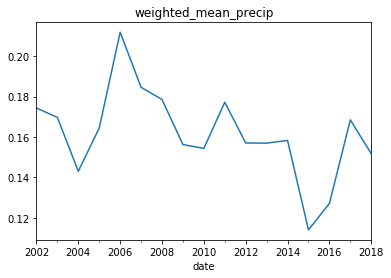

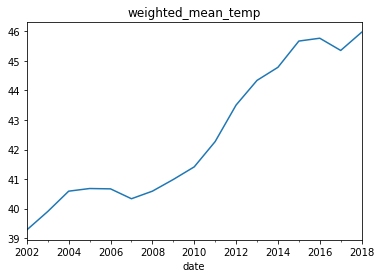

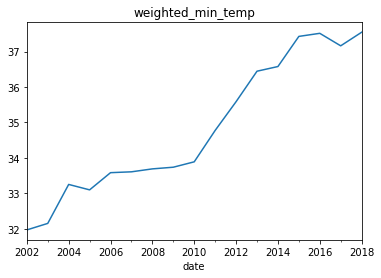

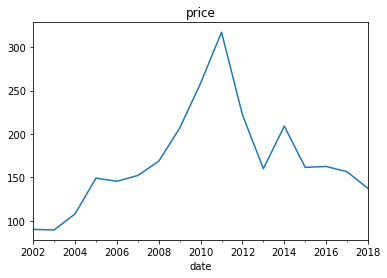

In [163]:
for col in weighted.columns:
    weighted[col].plot(title=col)
    plt.show()

In [4]:
from fbprophet import Prophet
from fbprophet.diagnostics import cross_validation, performance_metrics

In [165]:
weighted = weighted.reset_index()

In [166]:
weighted = weighted.rename(columns={'date': 'ds', 'price': 'y'})

In [167]:
m = Prophet()
for col in weighted.drop(columns=['y', 'ds']).columns:
    m.add_regressor(col)
m.fit(weighted)
cv = cross_validation(m, horizon='365 days')
performance_metrics(cv).rmse.mean()

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:n_changepoints greater than number of observations.Using 12.
INFO:fbprophet:Making 25 forecasts with cutoffs between 2005-01-04 00:00:00 and 2017-01-01 00:00:00
INFO:fbprophet:n_changepoints greater than number of observations.Using 2.
INFO:fbprophet:n_changepoints greater than number of observations.Using 2.
INFO:fbprophet:n_changepoints greater than number of observations.Using 3.
INFO:fbprophet:n_changepoints greater than number of observations.Using 3.
INFO:fbprophet:n_changepoints greater than number of observations.Using 3.
INFO:fbprophet:n_changepoints greater than number of observations.Using 3.
INFO:fbprophet:n_changepoints greater than number of observations.Using 4.
INFO:fbprophet:n_changepoints greater than number of observations.Using 4.
INFO:fbprophet:n_c

75.60078614725315

In [168]:
monthly = df['2002':]

In [169]:
monthly = monthly.drop()

,quantity,price,inflated,Caldas_mean_precip,Caldas_mean_temp,Caldas_min_temp,Cundinamarca_mean_precip,Cundinamarca_mean_temp,Cundinamarca_min_temp,Narino_mean_precip,...,Tolima_min_temp,Valle_mean_precip,Valle_mean_temp,Valle_min_temp,Cesar_mean_precip,Cesar_mean_temp,Cesar_min_temp,Santander_mean_precip,Santander_mean_temp,Santander_min_temp
date,,,,,,,,,,,,,,,,,,,,,
2002-01-01,824.0,62.462903,87.186616,0.046667,75.266667,61.0,0.065625,55.419355,34.0,0.138333,...,70.000000,0.164324,86.000000,76.0,0.477977,86.500000,72.0,0.041667,72.741935,51.0
2002-02-01,808.0,60.735714,84.775781,0.110000,74.058824,62.0,0.040667,57.214286,36.0,0.013333,...,67.000000,0.351667,84.714286,73.0,0.204686,86.916667,71.0,0.073077,73.000000,60.0
2002-03-01,778.0,68.598387,95.750612,0.110000,73.285714,64.0,0.185417,56.774194,38.0,0.112500,...,69.000000,1.016000,84.166667,72.0,0.190416,88.222222,73.0,0.162381,73.032258,63.0
2002-04-01,942.0,68.278333,95.303877,0.580909,73.000000,62.0,0.176957,57.266667,46.0,0.160000,...,71.000000,0.155000,82.545455,73.0,0.242065,89.000000,74.0,0.279231,71.200000,64.0
2002-05-01,1112.0,65.704839,91.711756,0.256667,75.000000,62.0,0.160455,58.032258,42.0,0.218750,...,72.243243,0.246667,82.812500,71.0,0.847500,88.500000,73.0,0.152800,72.870968,61.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-01,1258.0,130.993226,130.993226,0.086429,76.032258,57.0,0.057273,56.580645,41.0,0.074400,...,71.000000,0.095833,85.290323,72.0,0.168148,88.258065,72.0,0.181200,72.774194,63.0
2018-09-01,1050.0,126.525333,126.525333,0.396250,74.482759,61.0,0.131154,57.517241,40.0,0.078519,...,70.000000,0.416923,82.896552,72.0,0.166923,84.586207,72.0,0.144615,72.620690,62.0
2018-10-01,1086.0,138.804516,138.804516,0.347273,72.741935,60.0,0.096667,57.548387,43.0,0.102000,...,72.000000,0.441852,82.548387,71.0,0.146667,83.225806,71.0,0.341200,70.838710,62.0


In [175]:
prophet = monthly[['inflated', 'quantity']]
prophet = prophet.reset_index()
prophet = prophet.rename(columns={'inflated':'y', 'date':'ds'})
p = Prophet()
p.add_regressor('quantity')

In [176]:
p.fit(prophet)
cvp = cross_validation(p, horizon='365 days')
performance_metrics(cvp).rmse.mean()

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 26 forecasts with cutoffs between 2005-06-04 12:00:00 and 2017-12-01 00:00:00


58.44364651162887

In [172]:
q = Prophet()
q.fit(weighted)
cvq = cross_validation(q, horizon='365 days')
performance_metrics(cvq).rmse.mean()

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:n_changepoints greater than number of observations.Using 12.
INFO:fbprophet:Making 25 forecasts with cutoffs between 2005-01-04 00:00:00 and 2017-01-01 00:00:00
INFO:fbprophet:n_changepoints greater than number of observations.Using 2.
INFO:fbprophet:n_changepoints greater than number of observations.Using 2.
INFO:fbprophet:n_changepoints greater than number of observations.Using 3.
INFO:fbprophet:n_changepoints greater than number of observations.Using 3.
INFO:fbprophet:n_changepoints greater than number of observations.Using 3.
INFO:fbprophet:n_changepoints greater than number of observations.Using 3.
INFO:fbprophet:n_changepoints greater than number of observations.Using 4.
INFO:fbprophet:n_changepoints greater than number of observations.Using 4.
INFO:fbprophet:n_c

65.4435563716389

In [5]:
model = df['1995':]
model = model[['inflated', 'quantity']].reset_index().rename(columns={'inflated':'y', 'date':'ds'})

In [257]:
mod = Prophet()

In [258]:
mod.add_regressor('quantity')

In [259]:
mod.fit(model)

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [260]:
mod_cv = cross_validation(mod, horizon='365 days')

INFO:fbprophet:Making 40 forecasts with cutoffs between 1998-06-06 12:00:00 and 2017-12-01 00:00:00


In [261]:
performance_metrics(mod_cv).rmse.mean()

56.292296163050096

In [6]:
for year in ['1990', '1991', '1992', '1993', '1994', '1995', '1996', '1997', '1998', '1999']:
    place = df[year:]
    place = place[['inflated', 'quantity']].reset_index().\
    rename(columns={'inflated':'y', 'date':'ds'})
    k = Prophet()
    k.add_regressor('quantity')
    k.fit(place)
    k_cv = cross_validation(k, horizon='365 days')
    print(year)
    print(performance_metrics(k_cv).rmse.mean())

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 50 forecasts with cutoffs between 1993-06-07 12:00:00 and 2017-12-01 00:00:00
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 48 forecasts with cutoffs between 1994-06-07 12:00:00 and 2017-12-01 00:00:00


1990
81.4283058167292


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


1991
80.04723859495749


INFO:fbprophet:Making 46 forecasts with cutoffs between 1995-06-07 12:00:00 and 2017-12-01 00:00:00
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 44 forecasts with cutoffs between 1996-06-06 12:00:00 and 2017-12-01 00:00:00


1992
79.8382668269291


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


1993
71.8791158276162


INFO:fbprophet:Making 42 forecasts with cutoffs between 1997-06-06 12:00:00 and 2017-12-01 00:00:00
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


1994
60.99648871471633


INFO:fbprophet:Making 40 forecasts with cutoffs between 1998-06-06 12:00:00 and 2017-12-01 00:00:00
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 38 forecasts with cutoffs between 1999-06-06 12:00:00 and 2017-12-01 00:00:00


1995
56.292296163050096


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 36 forecasts with cutoffs between 2000-06-05 12:00:00 and 2017-12-01 00:00:00


1996
55.26874359721674


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 34 forecasts with cutoffs between 2001-06-05 12:00:00 and 2017-12-01 00:00:00


1997
53.49700170559275


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


1998
52.39146710379384


INFO:fbprophet:Making 32 forecasts with cutoffs between 2002-06-05 12:00:00 and 2017-12-01 00:00:00


1999
53.384822155647015


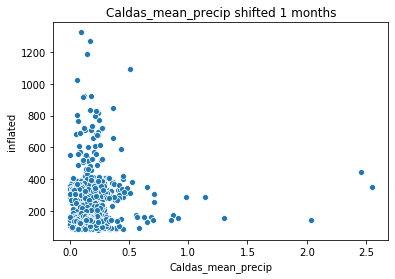

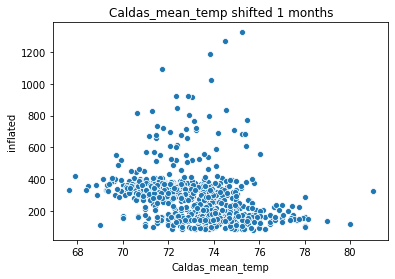

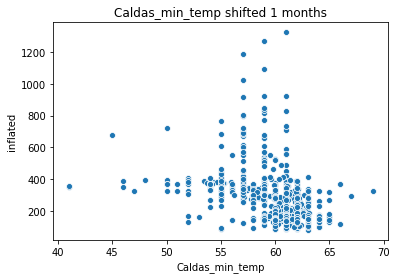

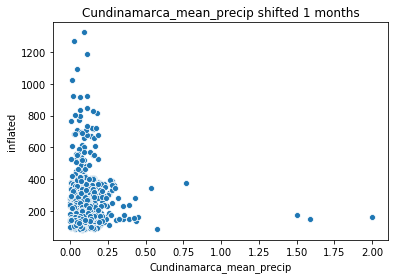

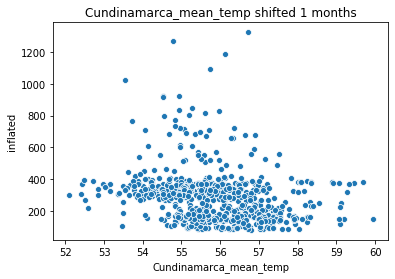

...

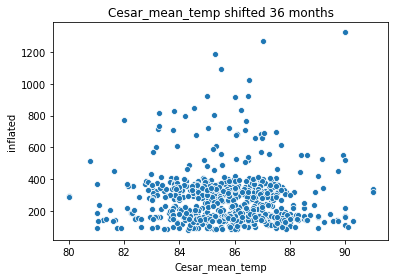

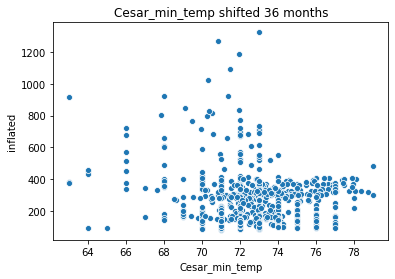

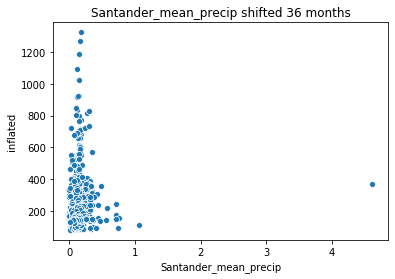

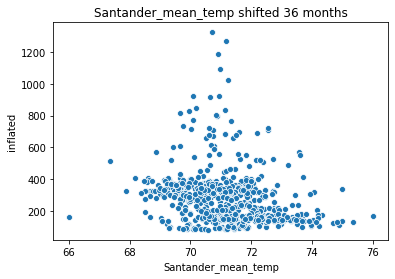

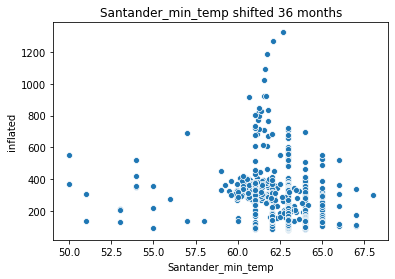

In [3]:
for month in range(1, 37):
    shifted = df[['inflated']].iloc[month:]
    for col in df.drop(columns=['inflated', 'price', 'quantity']):
        title = col + ' shifted ' + str(month) + ' months'
        shifted[col] = df[col].shift(month)
        sns.scatterplot(shifted[col], shifted.inflated).set_title(title)
        plt.show()

In [5]:
df[df.Tolima_mean_precip < 0].Tolima_mean_precip

date
1960-01-01   -0.194438
1960-02-01   -0.046946
1960-03-01   -0.117132
1960-11-01   -0.120419
1960-12-01   -0.127630
1961-01-01   -0.063621
1961-02-01   -0.161106
1961-03-01   -0.041836
1961-11-01   -0.042651
1961-12-01   -0.133187
1962-01-01   -0.096875
1962-02-01   -0.113048
1962-12-01   -0.139710
1963-01-01   -0.129405
1963-02-01   -0.063889
1963-04-01   -0.035822
1963-09-01   -0.007307
1963-12-01   -0.147190
1964-01-01   -0.161176
1964-02-01   -0.013685
1964-03-01   -0.083871
1964-11-01   -0.087157
1964-12-01   -0.094369
1965-01-01   -0.030359
1965-02-01   -0.127845
1965-03-01   -0.008575
1965-11-01   -0.009390
1965-12-01   -0.099926
1966-01-01   -0.063614
1966-02-01   -0.079787
1966-12-01   -0.106449
1967-01-01   -0.096144
1967-02-01   -0.030628
1967-04-01   -0.002561
1967-12-01   -0.113928
1968-01-01   -0.127915
1968-03-01   -0.050610
1968-11-01   -0.053896
1968-12-01   -0.061108
1969-02-01   -0.094583
1969-12-01   -0.066665
1970-01-01   -0.030352
1970-02-01   -0.046526
1970-1

In [1]:
import explore

Average Precipitation by Region of Colombia


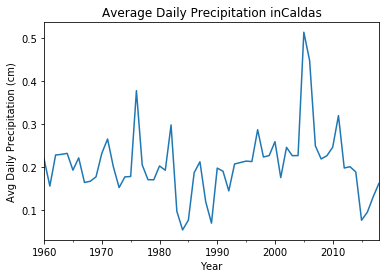

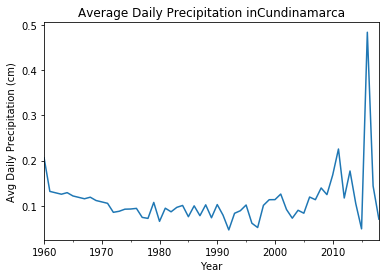

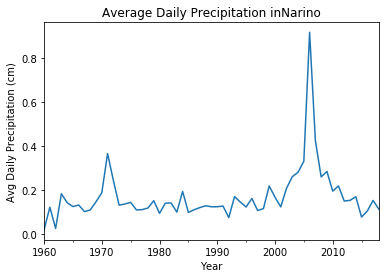

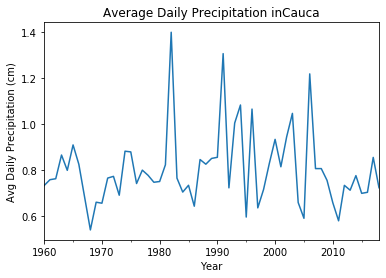

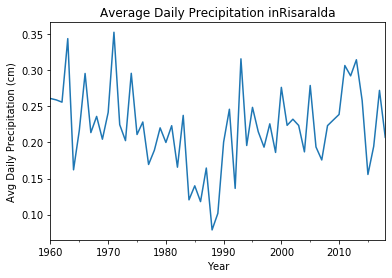

...

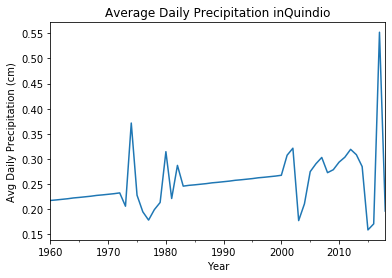

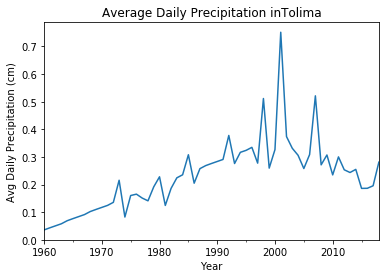

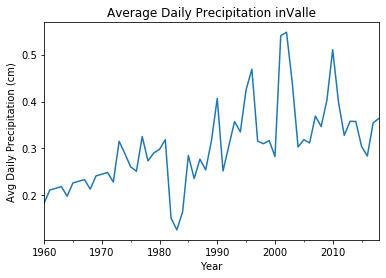

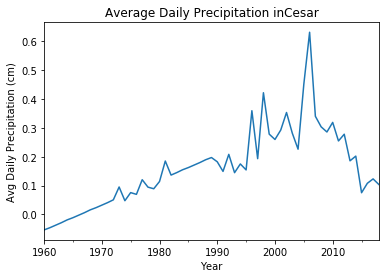

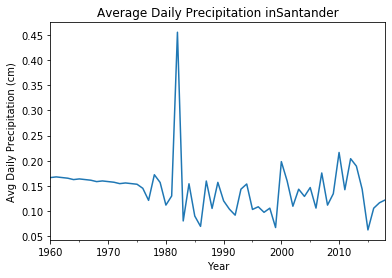

In [6]:
explore.precipitation_by_region(df)

In [5]:
pd.plotting.register_matplotlib_converters()